# ANAELE EXPLORATION

In [1]:
# Import required libraries to run the naive baseline
import pandas as pd
import numpy as np
from PIL import Image
from tqdm import tqdm
from collections import OrderedDict
import matplotlib.pyplot as plt
import pickle

import torch
import torch.nn as nn
import torchvision
import torchvision.transforms as transforms
from torchvision.models import mobilenet_v3_small

In [12]:
#############################################
# FUNCTIONS
#############################################

def show_images(df, image_dir, n_images=5, title='None'):
    N = len(df)
    plt.figure(figsize=(15, (N//5 + 1)*3))
    for i in range(N):
        plt.subplot(N//5 + 1, n_images, i + 1)
        img = Image.open(f"{image_dir}/{df.iloc[i]['filename']}")
        plt.imshow(img)
        plt.axis('off')
    plt.suptitle(title)
    plt.show()

In [3]:
df_train = pd.read_csv("listes_training/data_100K/train_100K.csv", delimiter=' ')
df_test = pd.read_csv("listes_training/data_100K/test_students.csv", delimiter=' ')

image_dir = "crops_100K"

df_train.head(-10)

,filename,FaceOcclusion,gender
0,database1/img00011271.jpg,0.019,0.999
1,database1/img00012471.jpg,0.035,1.000
2,database1/img00008127.jpg,0.127,0.001
3,database1/img00008972.jpg,0.014,0.999
4,database1/img00028187.jpg,0.346,0.982
...,...,...,...
101330,database3/database3/m.01drbr/59-FaceId-0_align...,0.000,1.000
101331,database3/database3/m.01drbr/69-FaceId-0_align...,0.021,0.998
101332,database3/database3/m.01drbr/7-FaceId-0_align.jpg,0.008,1.000
101333,database3/database3/m.01drbr/71-FaceId-0_align...,0.005,1.000


# 1 Data exploration

In [4]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101345 entries, 0 to 101344
Data columns (total 3 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   filename       101345 non-null  object 
 1   FaceOcclusion  101341 non-null  float64
 2   gender         101345 non-null  float64
dtypes: float64(2), object(1)
memory usage: 2.3+ MB


In [5]:
# drop the rows where FaceOcclusion is empty

df_train = df_train.dropna(subset=['FaceOcclusion'])
df_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 101341 entries, 0 to 101344
Data columns (total 3 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   filename       101341 non-null  object 
 1   FaceOcclusion  101341 non-null  float64
 2   gender         101341 non-null  float64
dtypes: float64(2), object(1)
memory usage: 3.1+ MB


In [6]:
df_train.describe()

,FaceOcclusion,gender
count,101341.000000,101341.000000
mean,0.087769,0.599738
std,0.090530,0.486110
min,0.000000,0.000000
25%,0.019000,0.001000
50%,0.054000,0.996000
75%,0.131000,0.999000
max,1.000000,1.000000


## 1.1 Gender distribution (40% Women - 60% Men)

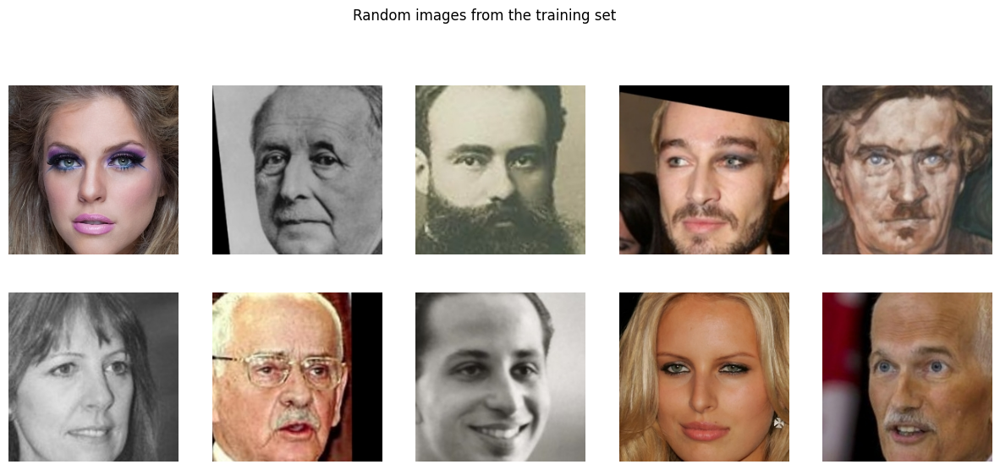

In [14]:
show_images(df_train.sample(10), image_dir, title='Random images from the training set')

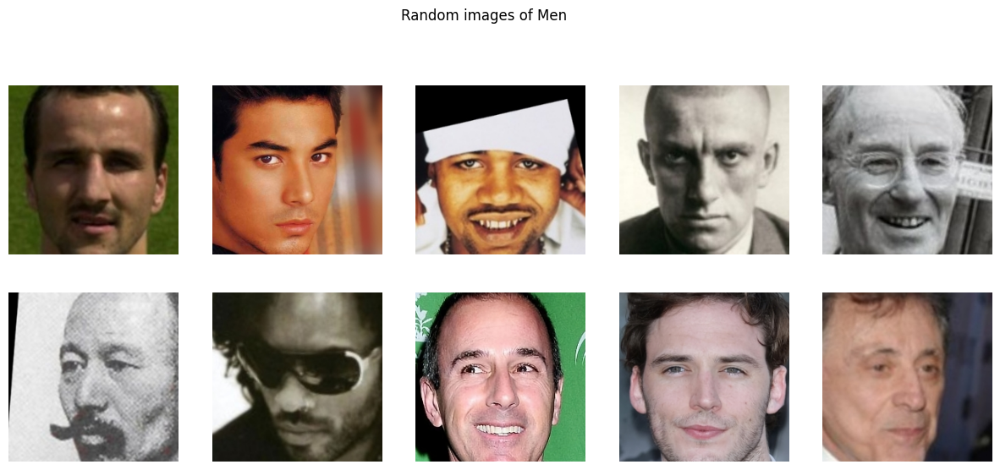

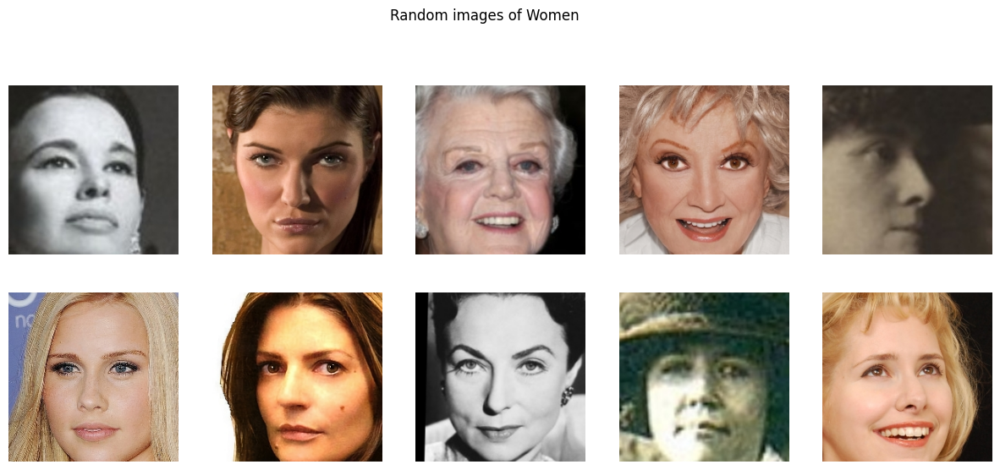

In [15]:
men = df_train[df_train['gender']>0.5]
women = df_train[df_train['gender']<0.5]

show_images(men.sample(10), image_dir, title='Random images of Men')
show_images(women.sample(10), image_dir, title='Random images of Women')

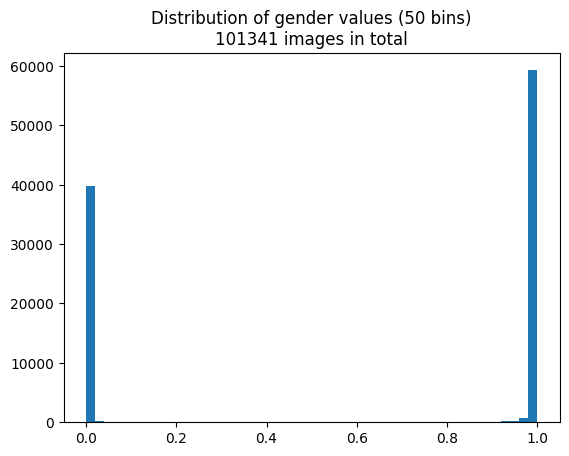

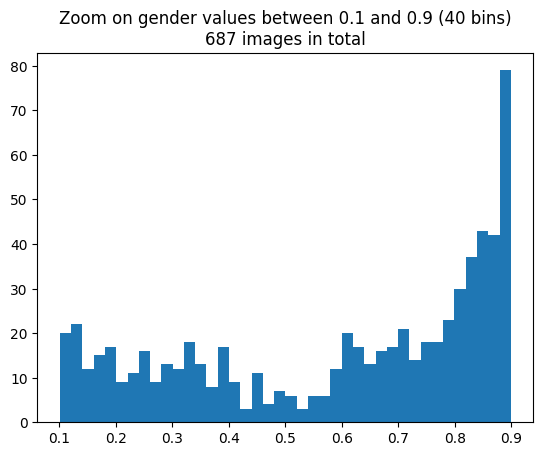

67


In [7]:
# Plot histogram of Gender with 50 baskets
# 0 = Women and 1 = Men
plt.hist(df_train['gender'], bins=50)
plt.title('Distribution of gender values (50 bins)\n'+str(df_train.shape[0])+' images in total')
plt.show()

# Plot histogram of gender between 0.1 and 0.9 with 40 baskets
gender_mixed = df_train[(df_train['gender'] > 0.1) & (df_train['gender'] < 0.9)]
plt.hist(gender_mixed['gender'], bins=40)
plt.title('Zoom on gender values between 0.1 and 0.9 (40 bins)\n'+str(gender_mixed.shape[0])+' images in total')
plt.show()
df_gender_4_6 = df_train[(df_train['gender'] > 0.4) & (df_train['gender'] < 0.6)]
print(len(df_gender_4_6))

Men


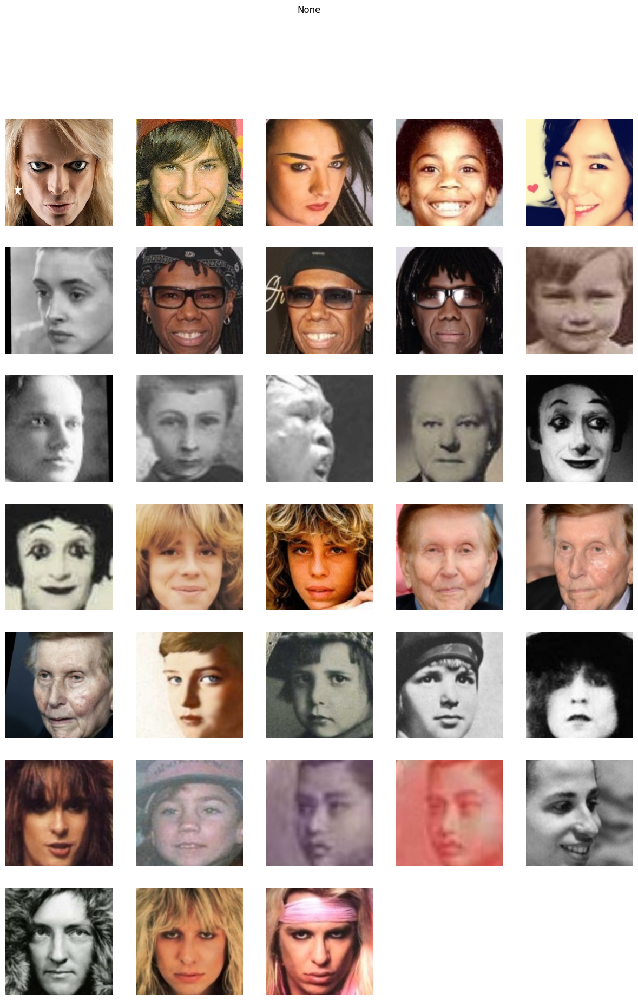

Women


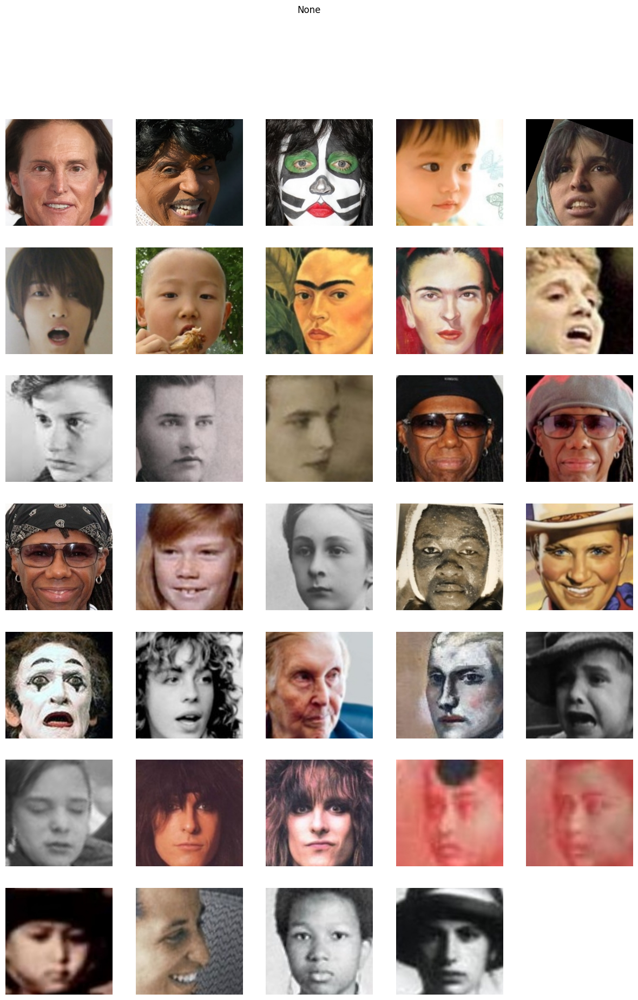

In [13]:
# show images in df_gender_4_6 (5 on each row)

#show_images(df_gender_4_6, image_dir, n_images=5)
# plot woman gender>0.5
print('Men')
show_images(df_gender_4_6[df_gender_4_6['gender'] > 0.5], image_dir, n_images=5)
print('Women')
show_images(df_gender_4_6[df_gender_4_6['gender'] < 0.5], image_dir, n_images=5)

## 1.1. Face occlusion Distribution analysis

n 101341


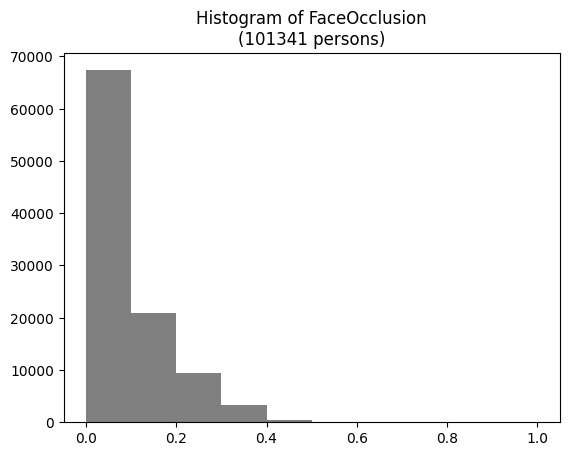

In [ ]:
# Plot histogram of Faceocclusion with 10 baskets
n = df_train.shape[0]
print('n',n)
plt.hist(df_train['FaceOcclusion'], bins=10,color='gray')
plt.title('Histogram of FaceOcclusion\n('+str(n)+' persons)')
plt.show()

Text(0.5, 1.0, 'number of men and women in each bin of 0.01 of FaceOcclusion')

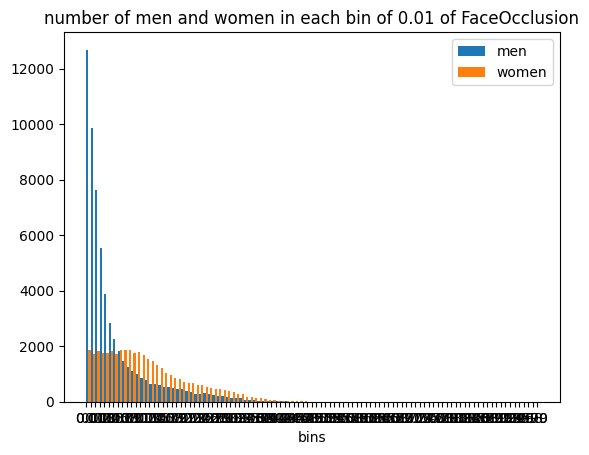

In [ ]:
n_bins = 100

# Extracting histogram values for men
counts_men, bin_edges_men = np.histogram(men['FaceOcclusion'], bins=n_bins)

# Extracting histogram values for women
counts_women, bin_edges_women = np.histogram(women['FaceOcclusion'], bins=n_bins)

plt.bar(np.arange(n_bins)+0.25,counts_men, label = "men",width=0.5)
plt.bar(np.arange(n_bins)+0.75,counts_women, label = "women", width=0.5)
plt.legend()
plt.xlabel('bins')
plt.xticks(np.arange(n_bins+1),np.arange(n_bins+1)/n_bins, )
plt.title('number of men and women in each bin of '+ str(1/n_bins)+' of FaceOcclusion')

# IMAGES BY DESCENDING OCCLUSION

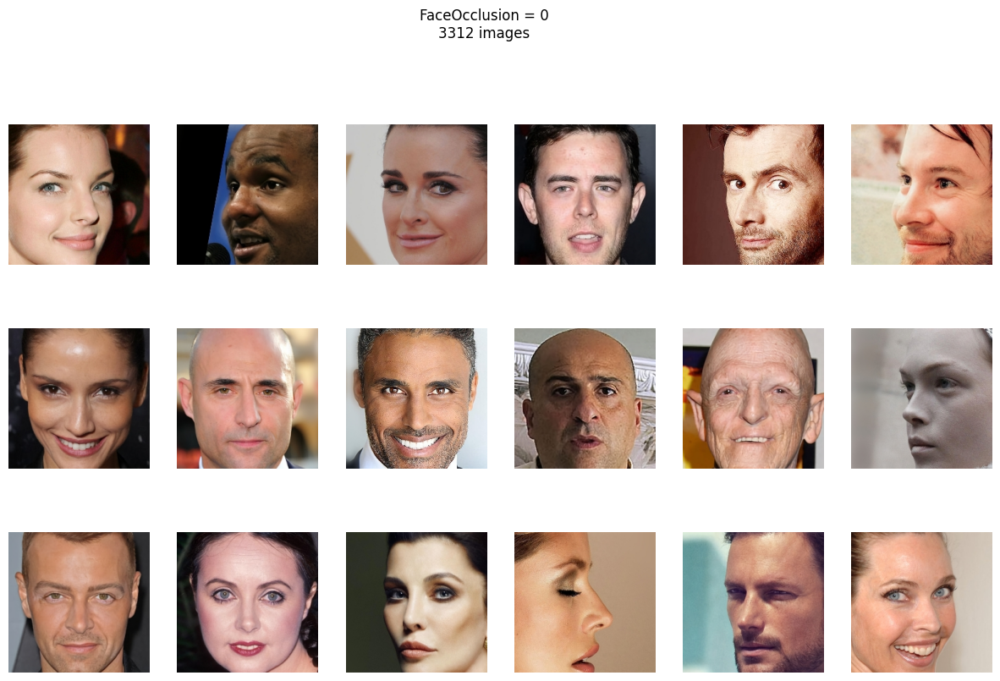

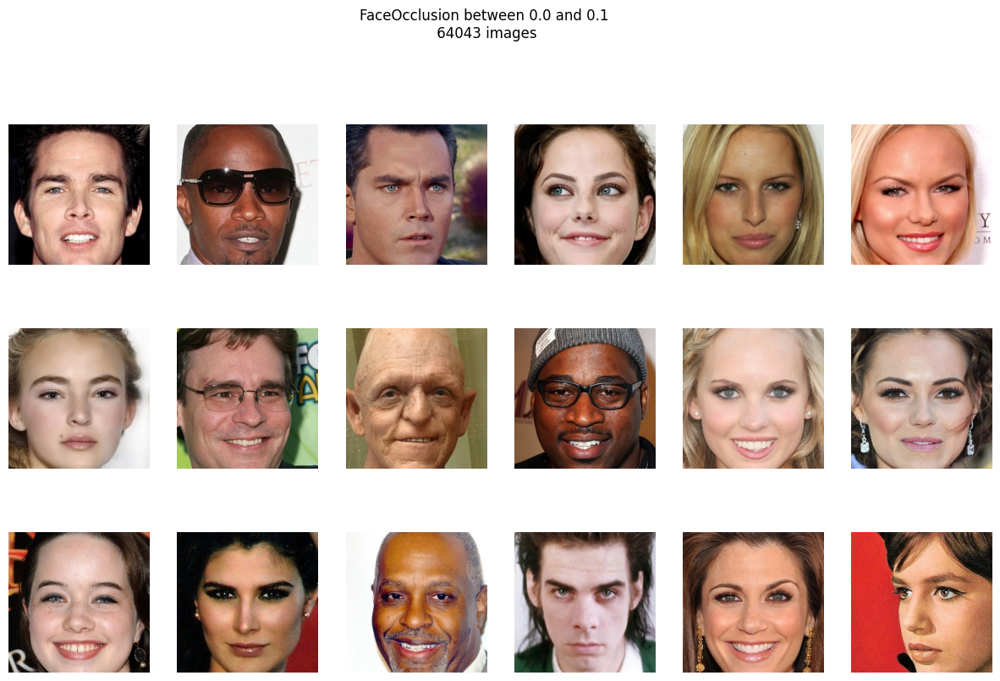

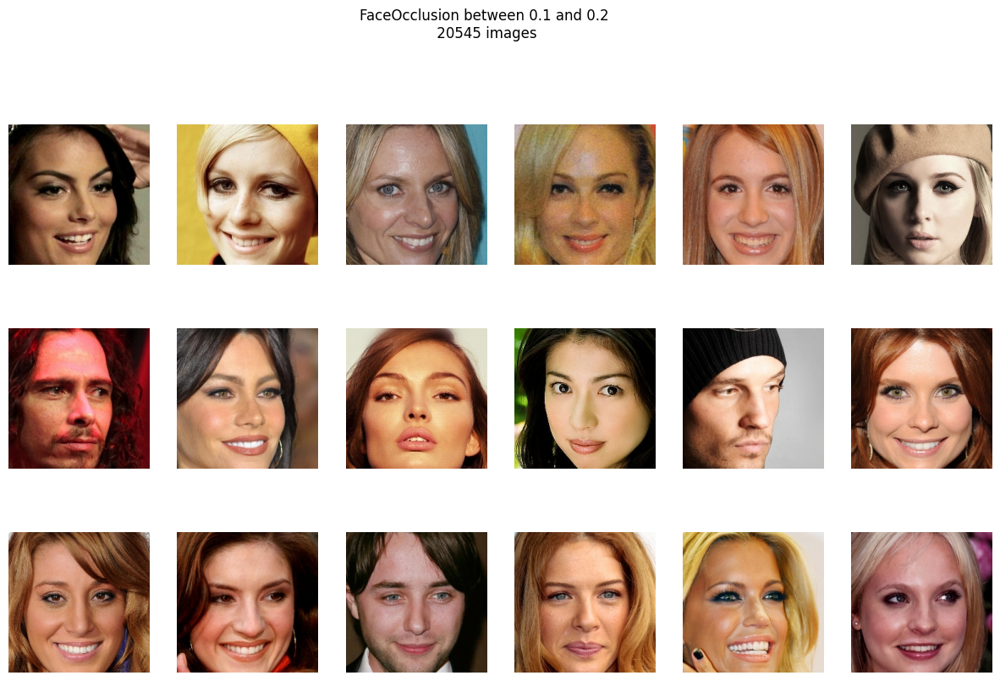

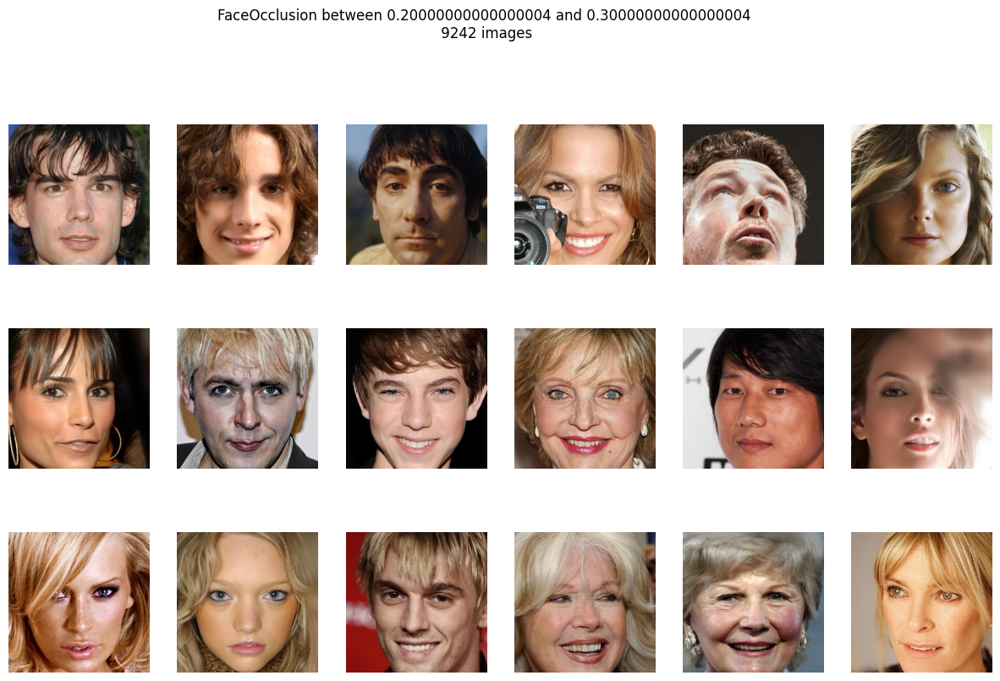

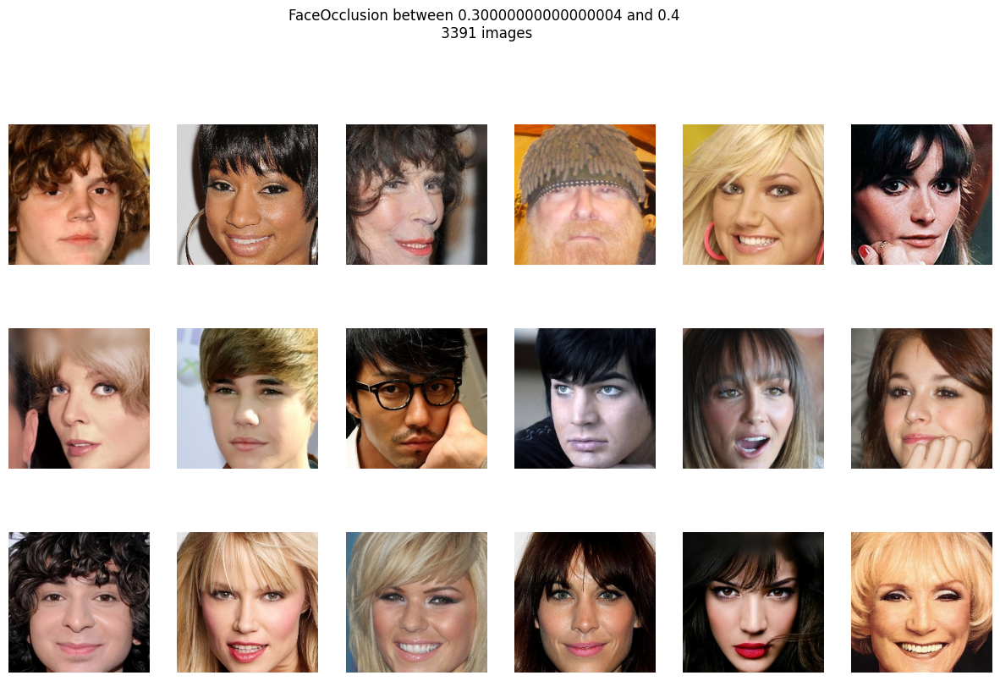

...

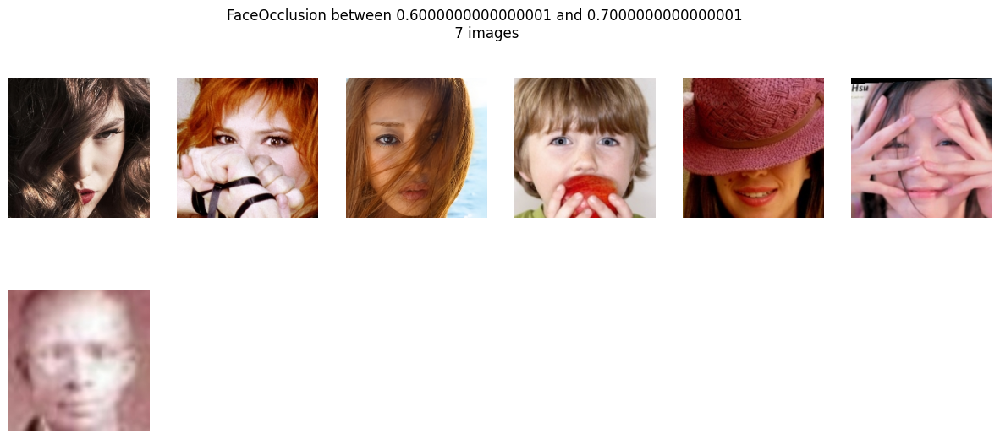

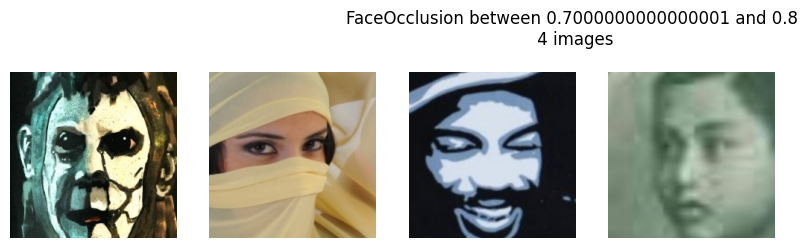

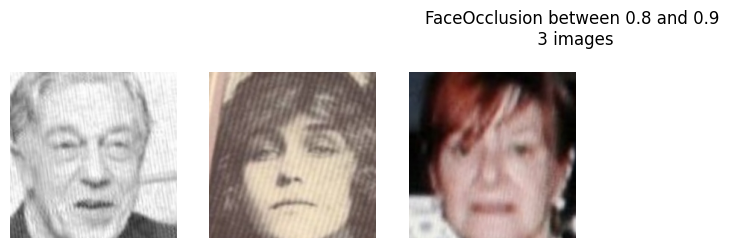

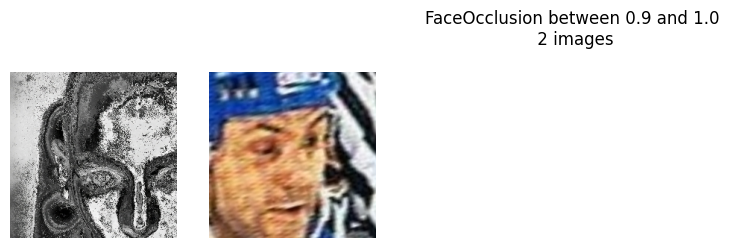

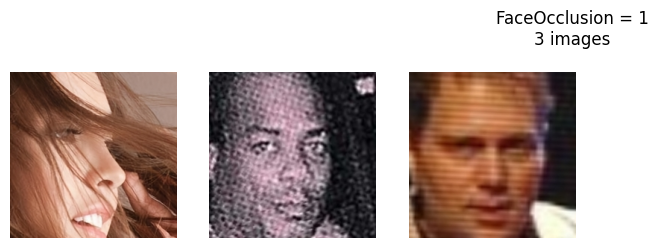

In [24]:
# show images grouped by occlusion level

bins = np.arange(0.1, 1.1, 0.1)
n_img = 18

# Show images with FaceOcclusion = 0, ]0, 0.1[, ]0.1, 0.2[, ... ]0.9, 1], =1
show_images (df_train[df_train['FaceOcclusion']==0].head(n_img), image_dir, n_images=6, title="FaceOcclusion = 0\n"+str(len(df_train[df_train['FaceOcclusion']==0]))+" images")
for b in bins:
    selection = df_train[(df_train['FaceOcclusion'] > b - 0.1 ) & (df_train['FaceOcclusion'] < b)]
    title_bin = f"FaceOcclusion between {b - 0.1} and {b}\n {len(selection)} images"
    show_images (selection.head(n_img), image_dir, n_images=6, title=title_bin)
show_images (df_train[df_train['FaceOcclusion']==1].head(n_img), image_dir, n_images=6, title="FaceOcclusion = 1\n"+str(len(df_train[df_train['FaceOcclusion']==1]))+" images")

# 1.3 Explore by data set and black and white images

In [30]:
# Create a column with the database number

df_train['db_number'] = df_train['filename'].apply(lambda x: x[8:9])

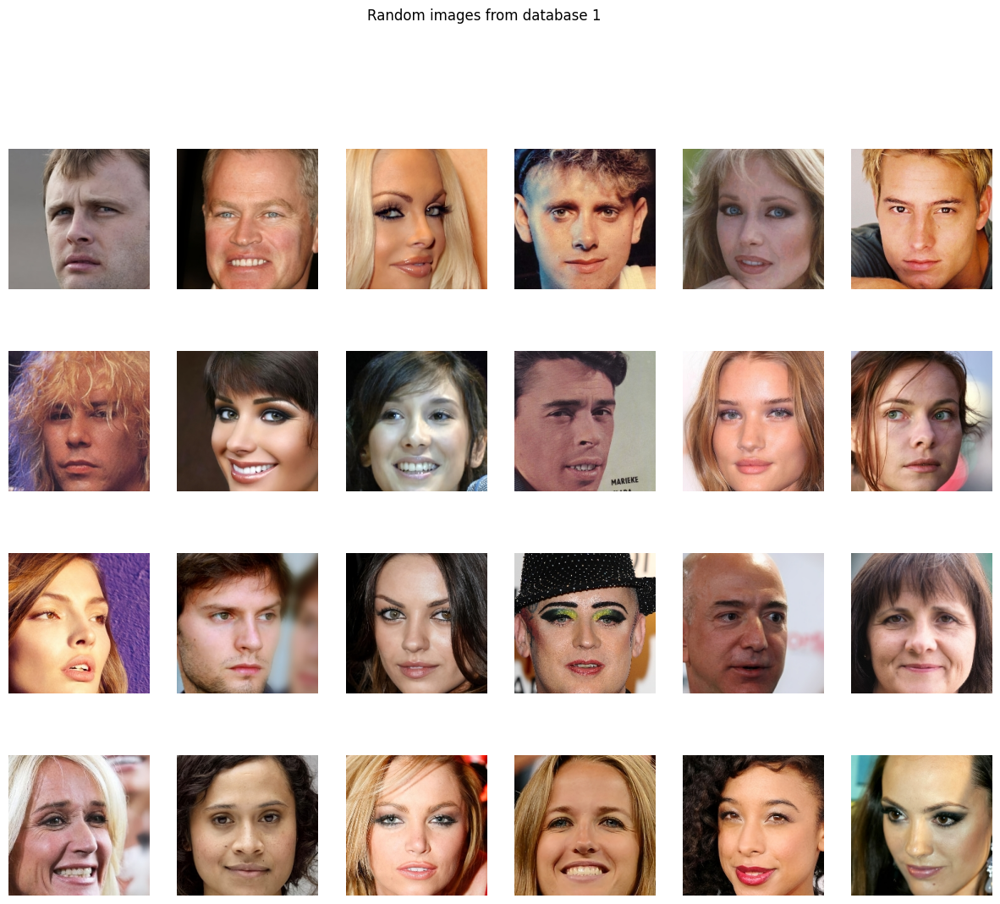

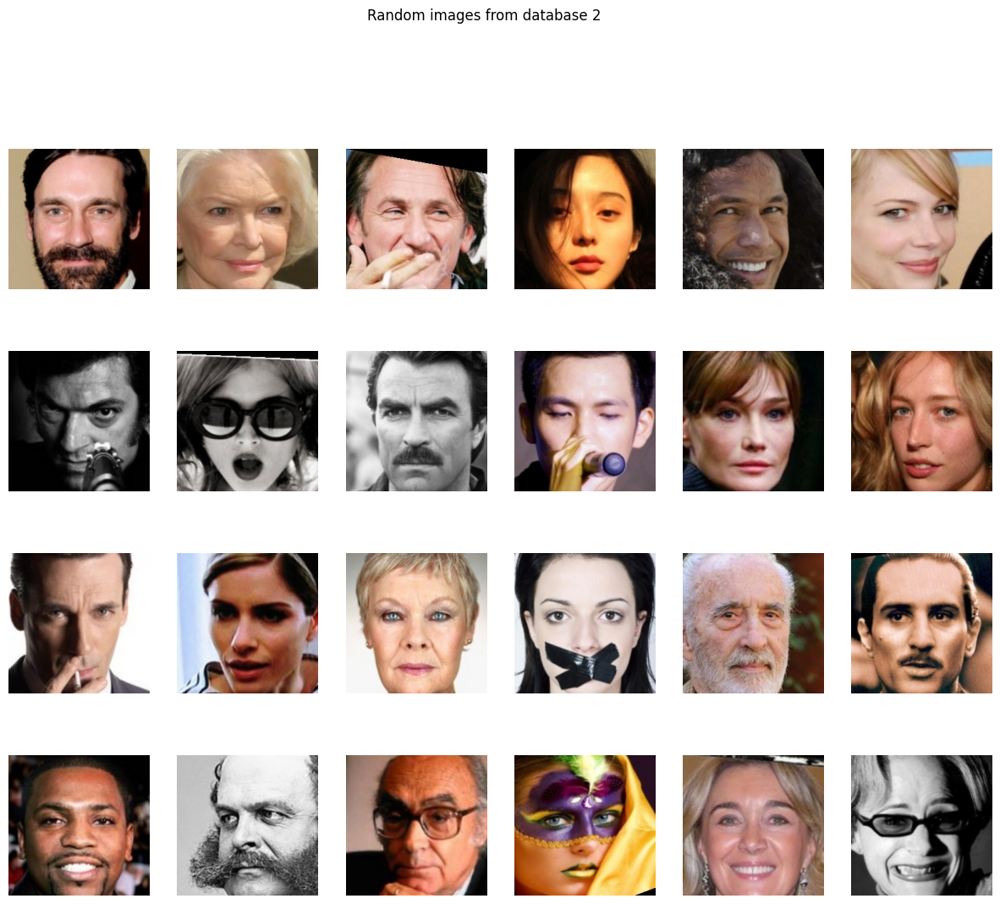

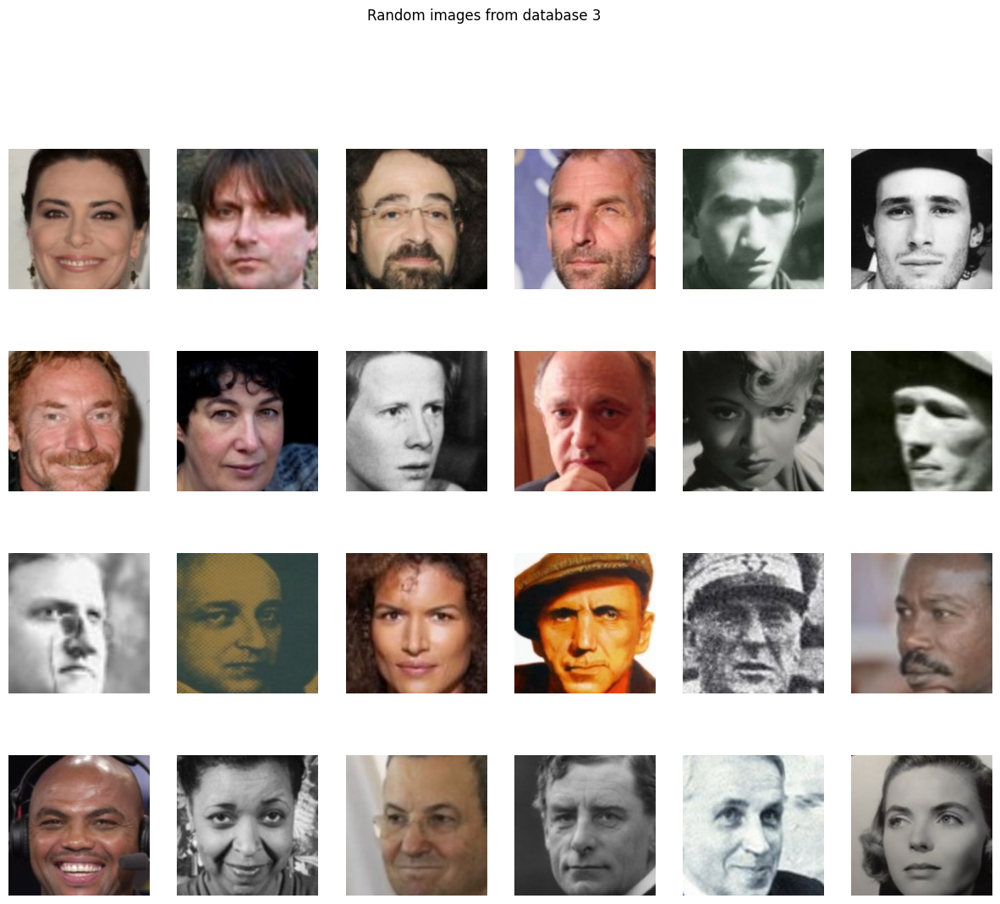

In [28]:
df_1 = df_train[df_train['filename'].str.contains('database1', na=False)]
df_2 = df_train[df_train['filename'].str.contains('database2', na=False)]
df_3 = df_train[df_train['filename'].str.contains('database3', na=False)]

n_samples = 24
show_images(df_1.sample(n_samples), image_dir, n_images=6 ,title='Random images from database 1')
show_images(df_2.sample(n_samples), image_dir, n_images=6 ,title='Random images from database 2')
show_images(df_3.sample(n_samples), image_dir, n_images=6 ,title='Random images from database 3')

black and white image (224, 224, 3) True
color image (224, 224, 3) False


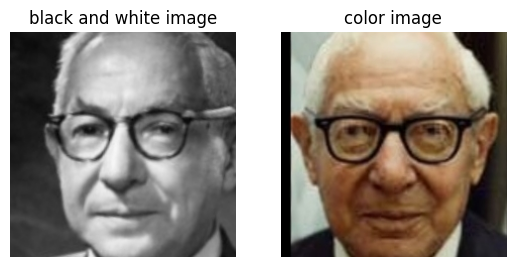

In [79]:
# function to check if image is balck and white


def is_black_and_white(img):
    # check if image has 2 channels
    dim = len(np.array(color_img).shape)
    
    if dim == 2:
        return True
    # check if image has 3 channels and all channels are equal
    elif dim == 3:
        if ((np.array(img)[:,:,2] == np.array(img)[:,:,1]).all() == True &
            (np.array(img)[:,:,0] == np.array(img)[:,:,1]).all() == True &
            (np.array(img)[:,:,0] == np.array(img)[:,:,2]).all() == True ):
            return True
        else:
            return False
    else:
        return False



bw_img = Image.open("crops_100K/database3/database3/m.01b_6y/40-FaceId-0_align.jpg")
print('black and white image:',np.array(bw_img).shape, is_black_and_white(bw_img))

color_img = Image.open("crops_100K/database3/database3/m.01b_6y/33-FaceId-0_align.jpg")
print('color image:',np.array(color_img).shape, is_black_and_white(color_img))

# test the function
plt.subplot(1,2,1)
plt.imshow(bw_img)
plt.title('black and white image')
plt.axis('off')
plt.subplot(1,2,2)
plt.imshow(color_img)
plt.title('color image')
plt.axis('off')
plt.show()

In [80]:
# Add a column to the dataframe with the information if the image is black and white

res =[]

for i in range(len(df_train)):
    if i % 5000 == 0: print(i)
    img = Image.open(f"{image_dir}/{df_train.iloc[i]['filename']}")
    res.append( is_black_and_white(img) )

df_train['black_and_white'] = res

0
5000
10000
15000
20000
25000
30000


In [66]:
# count the number of black and white images per database
df_train['count'] = 1
black_white_stats = df_train.groupby('db_number')['black_and_white','count','gender'].sum()

/tmp/ipykernel_110340/3742428360.py:3: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  black_white_stats = df_train.groupby('db_number')['black_and_white','count','gender'].sum()


In [67]:
black_white_stats

,black_and_white,count,gender
db_number,,,
1,30000,30000,10832.949
2,1345,1345,718.256
3,69996,69996,49226.888


In [71]:
(df_train['black_and_white']==False).sum()

0

In [ ]:
# Explore other features
# ---------------------- 
# skin color
# age
# glasses
# hair color
# hair length
# facial hair
# head pose
# hat

# SAVE DATAFRAME

In [ ]:
with open('df_train.pkl', 'wb') as f:
    pickle.dump(df_train, f)

2024-06-08 18:21:49.783848: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-06-08 18:21:50.142511: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-06-08 18:21:51.368013: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
[ WARN:0@4.815] global loadsave.cpp:241 findDecoder imread_('database1/img00011271.jpg'): can't open/read file: check file path/integrity
INFO: Created TensorFlow Lite XNNPACK delegate for CPU.
W0000 00:00:1717863713.390234   51046 inference_feedback

error: OpenCV(4.10.0) /io/opencv/modules/imgproc/src/color.cpp:196: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'
